In [1]:
from pystac_client import Client
import geopandas as gpd
import folium
from odc.stac import configure_s3_access
from dea_tools.dask import create_local_dask_cluster

from dep_tools.searchers import PystacSearcher
from dep_tools.loaders import OdcLoader
from src.util import MangrovesProcessor

from dep_tools.grids import PACIFIC_GRID_10 as grid

In [2]:
# Reload functions
%load_ext autoreload
%autoreload 2

In [3]:
configure_s3_access()
client = create_local_dask_cluster(return_client=True)

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /user/nicholasm@spc.int/proxy/8787/status,
Dashboard: /user/nicholasm@spc.int/proxy/8787/status,Workers: 1
Total threads: 8,Total memory: 57.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:44625,Workers: 0
Dashboard: /user/nicholasm@spc.int/proxy/8787/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:43403,Total threads: 8
Dashboard: /user/nicholasm@spc.int/proxy/38419/status,Memory: 57.00 GiB
Nanny: tcp://127.0.0.1:35157,


In [4]:
catalog = "https://stac.digitalearthpacific.org"
collection = "dep_s2_geomad"
client = Client.open(catalog)

year = "2020"

tile_index = (63, 20)  # Fiji
# tile_index = (66, 20)  # Antimeridian area

geobox = grid.tile_geobox(tile_index)
geobox.explore()

In [5]:
searcher = PystacSearcher(catalog=catalog, collections=[collection], datetime=year)

items = searcher.search(area=geobox)

print(f"Found {len(items)} items")

Found 6 items


In [6]:
loader = OdcLoader(
    bands=[
        "nir",
        "red",
        "green",
        "blue",
        "swir16",
    ],
    groupby="solar_day",
    fail_on_error=False,
    clip_to_area=False,
    chunks={"x": 2048, "y": 2048},
)

data = loader.load(items, areas=geobox)

# Load into memory
data = data.compute()

data

<xarray.Dataset> Size: 922MB
Dimensions:      (y: 9600, x: 9600, time: 1)
Coordinates:
  * y            (y) float64 77kB -1.984e+06 -1.984e+06 ... -2.08e+06 -2.08e+06
  * x            (x) float64 77kB 3.048e+06 3.048e+06 ... 3.144e+06 3.144e+06
    spatial_ref  int32 4B 3832
  * time         (time) datetime64[ns] 8B 2020-01-01
Data variables:
    nir          (time, y, x) uint16 184MB 1919 1955 1966 2036 ... 320 325 330
    red          (time, y, x) uint16 184MB 217 220 216 214 ... 352 348 349 362
    green        (time, y, x) uint16 184MB 380 380 375 382 ... 417 404 407 416
    blue         (time, y, x) uint16 184MB 191 188 187 181 ... 560 547 547 557
    swir16       (time, y, x) uint16 184MB 638 658 659 673 ... 328 331 345 346

In [7]:
processor = MangrovesProcessor(areas=geobox)

output = processor.process(data, debug=True)
output

/srv/conda/envs/notebook/lib/python3.11/site-packages/xarray/core/duck_array_ops.py:244: RuntimeWarning: invalid value encountered in cast
  return data.astype(dtype, **kwargs)


<xarray.Dataset> Size: 645MB
Dimensions:             (y: 9600, x: 9600)
Coordinates:
  * y                   (y) float64 77kB -1.984e+06 -1.984e+06 ... -2.08e+06
  * x                   (x) float64 77kB 3.048e+06 3.048e+06 ... 3.144e+06
    spatial_ref         int32 4B 3832
    time                datetime64[ns] 8B 2020-01-01
Data variables:
    blue                (y, x) uint8 92MB 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0
    ammi                (y, x) uint8 92MB 5 4 5 5 5 4 4 3 3 ... 0 0 0 0 0 0 0 0
    mangroves           (y, x) uint8 92MB 16 10 16 16 16 ... 255 255 255 255 255
    mangroves_pre_mask  (y, x) uint8 92MB 16 10 16 16 16 ... 255 255 255 255 255
    elevation_mask      (y, x) uint8 92MB 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1
    water               (y, x) uint8 92MB 1 1 1 1 1 1 1 1 1 ... 0 0 0 0 0 0 0 0
    water_mask          (y, x) uint8 92MB 1 1 1 1 1 1 1 1 1 ... 0 0 0 0 0 0 0 0

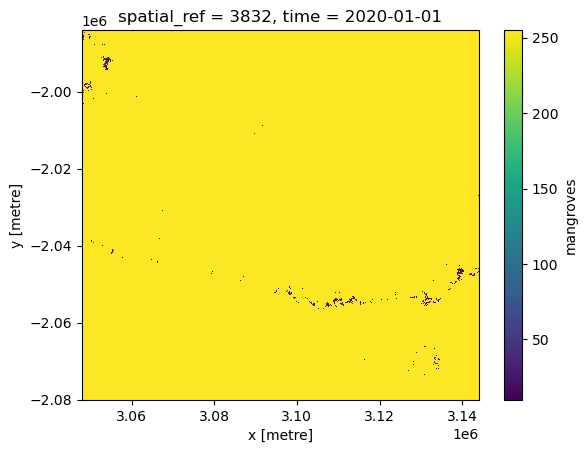

In [8]:
output.mangroves.plot.imshow()

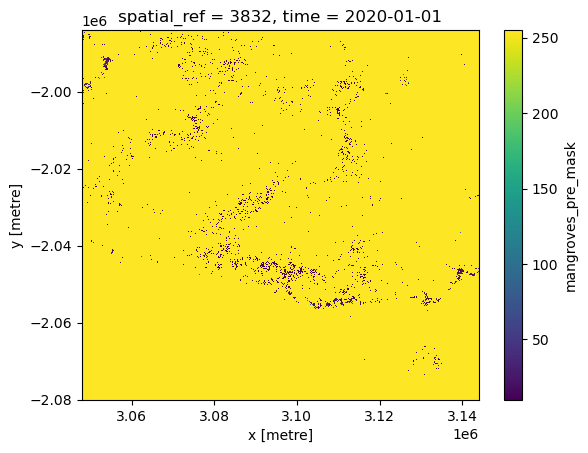

In [9]:
mangroves = output.mangroves_pre_mask.where(output.mangroves != 0, drop=True)
mangroves.plot.imshow()

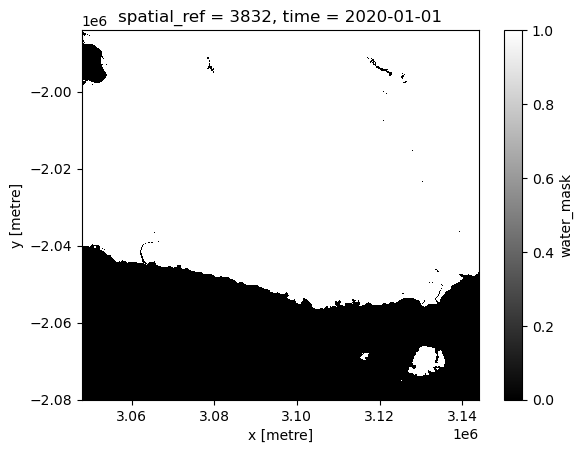

In [10]:
output.water_mask.plot.imshow(cmap="gray")

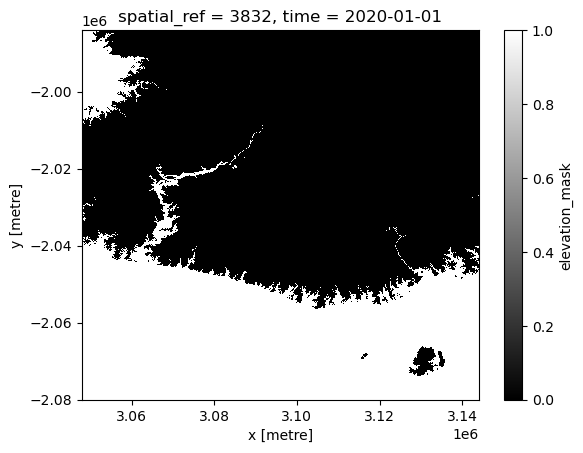

In [11]:
output.elevation_mask.plot.imshow(cmap="gray")

### Visual Verification

In [12]:
gdf = gpd.read_parquet("gmw_v4_pacific_validation.parquet")
aoi = geobox.extent.to_crs(3832)
gdf = gdf.clip(aoi.geom, keep_geom_type=False)
gdf.COUNTRY.unique()

array(['Fiji'], dtype=object)

In [13]:
# Compute the RGB into memory
#rgb_ds = data.odc.to_rgba(vmin=0, vmax=0.3, bands=("red", "green", "blue")).compute()

In [14]:
# Initialize the Folium map centered on the average centroid
x, y = aoi.centroid.to_crs("epsg:4326").xy
m = folium.Map(location=[float(y[0]), float(x[0])], zoom_start=10)

# GMW for Validation
# gdf.geometry.boundary.explore(m=m, color="red", name="GMWv4")
gdf.explore(
    m=m,
    name="GMWv4",
    style_kwds=dict(
        fillOpacity=0.5,  # Sets the opacity of the fill color
        opacity=1.0,  # Sets the opacity of the outline color
        color="red",  # Outline color
        fillColor="green",
    ),
)

# RGB for Comparison
rgb = data.odc.to_rgba(bands=("red", "green", "blue"), vmin=0, vmax=3000)
rgb.odc.add_to(m, name="RGB")

# Mangrove Mask and Density
output.mangroves.odc.add_to(m, cmap="viridis", name="Mangroves")

folium.LayerControl().add_to(m)

m

### Export

In [ ]:
# output.mangroves.odc.write_cog(f"output_{year}.tif", overwrite=True)